### Overview

0. Google 
1. Hematopoiesis
2. CellRanger
3. Scanpy and AnnData
3. Quality control, Normalization
4. Dimensionality reduction with PCA
5. Cell-cell distances
6. Unsupervised clustering with Leiden

### Google Colab
- For a simple intro see https://compscbio.github.io/cscb2026/notebooks/colab.html
- Cloud compute resource
- To sign up for free educational user account: https://colab.research.google.com/signup
- To start using Colab directly: https://colab.research.google.com/#
- You can launch a copy of the notebook that you are feasting your eyes upon now in Colab by selecting File -> Open Notebook -> GitHub, then copy and paste this URL into the search field: https://github.com/compscbio/cscb2026/blob/gh-pages/notebooks/scBasics.ipynb

### Background on the data
Let's start with some background + motivation for the data set that we are going to analyze: hematopoietic cells from peripheral blood.

#### Hematopoiesis 

<figure>
    <img src="./img/Hematopoiesis.png" alt="Hematopoiesis" width="600">
    <figcaption>Traditional model of hematopoiesis. Image from <a href="https://onlinelibrary.wiley.com/doi/book/10.1002/9781119235293">Slack 2017</a></figcaption>
</figure>

These cells are produced in the bone marrow and then move into the vascular so that they can move about the body and perform their functions (transport oxygen, clot, do adaptive and innate immune things). 

#### Peripheral blood mononuclear cells (PBMCs)
It is possible to enrich for what are called PBMCs that have been taken from from a donor's vein, and then performing density gradient centrifugation. This process enriches for cells that have a single, round nucleus, and it excludes other stuff. PBMCs typically contain:

> ... several classes of immune cells, including T cells (\~70%), B cells (\~15%), monocytes (\~5%), dendritic cells (\~1%) and natural killer (NK) cells (~10%)
> <br>    --  [Sen et al 2019](https://www.frontiersin.org/articles/10.3389/fmolb.2017.00096/)

and

> ... The CD3+ lymphocytes are composed of CD4+ and CD8+ T cells, roughly in a 2:1 ratio.
> <br>    -- [Kleiveland, 2015](https://library.oapen.org/bitstream/handle/20.500.12657/28028/1001968.pdf?seque)


### Some questions we can explore
- What does scRNAseq estimate as the relative cell type proportions?
- Are there other genes that are better at distinguishing between these populations than marker genes listed below? 
- How many cells do you need to reliably detect a sub-population?

### Data
- 10X Genomics scRNA-seq on human PBMCs from a healthy donor
- About 10,000 cells
- http://cf.10xgenomics.com/samples/cell-exp/1.1.0/pbmc3k/pbmc3k_filtered_gene_bc_matrices.tar.gz

### CellRanger
CellRanger is the program that converts sequencing reads into gene expression counts.

<figure>
    <img src="./img/cellranger_flow_1.png" alt="CellRanger flowchart 1" width="600">
    <figcaption>CellRanger flow chart from <a href="https://www.10xgenomics.com/support/software/cell-ranger/latest/algorithms-overview/cr-gex-algorithm">10X genomics</a></figcaption>
</figure>


Here is a more detailed glimpse of what is happening here:

<figure>
    <img src="img/cellranger_flow_2.png" alt="CellRanger flowchart 2" width="400">
    <figcaption>CellRanger flow chart 2 from <a href="https://www.10xgenomics.com/support/software/cell-ranger/latest/algorithms-overview/cr-gex-algorithm">10X genomics</a></figcaption>
</figure>

- Trims reads
- Splicing aware alignment to reference genome
- deals wth reads mapping to > 1 locus

<figure>
    <img src="img/cellranger_mapping.jpeg" alt="CellRanger mapping" width="600">
    <figcaption>CellRanger mapping from <a href="https://www.10xgenomics.com/support/software/cell-ranger/latest/algorithms-overview/cr-gex-algorithm">10X genomics</a></figcaption>
</figure>

### UMI counting

- group reads with same cell bc, umi, gene
- correct umis (one base off)
- cell bc, umi, diff gene -> only keep gene with most support
- discard both if tied
- all reads with same cell bc, umi, gene are counted as one UMI
- number of reads contributing to that UMI are stored in molecule info file (useful later)

#### Setting up our Colab environment

Note that lines starting with `!` send the remaining line to the shell

In [1]:
!pip install scanpy python-igraph scipy umap-learn leidenalg

#### Fetch the data

In [2]:
!wget https://cf.10xgenomics.com/samples/cell-exp/3.0.0/pbmc_10k_v3/pbmc_10k_v3_filtered_feature_bc_matrix.h5

--2026-01-27 10:40:49--  https://cf.10xgenomics.com/samples/cell-exp/3.0.0/pbmc_10k_v3/pbmc_10k_v3_filtered_feature_bc_matrix.h5
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.1.173, 104.18.0.173
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|104.18.1.173|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 37491093 (36M) [binary/octet-stream]
Saving to: ‘pbmc_10k_v3_filtered_feature_bc_matrix.h5’

pbmc_10k_v3_filtere 100%[===================>]  35.75M  36.9MB/s    in 1.0s    

2026-01-27 10:40:51 (36.9 MB/s) - ‘pbmc_10k_v3_filtered_feature_bc_matrix.h5’ saved [37491093/37491093]



#### Set up our Python session

In [3]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
plt.rcParams['figure.dpi'] = 300
sc.logging.print_header()

scanpy==1.10.4 anndata==0.11.3 umap==0.5.7 numpy==1.26.4 scipy==1.15.1 pandas==2.2.3 scikit-learn==1.6.1 statsmodels==0.14.4 igraph==0.11.8 pynndescent==0.5.13


#### Load Sample 1

In [4]:
ad10f = sc.read_10x_h5("pbmc_10k_v3_filtered_feature_bc_matrix.h5")

#### Getting information about functions
You can get info about functions using
> help(functionName)

or

> ?functionName


In [5]:
?sc.read_10x_h5

Signature:
sc.read_10x_h5(
    filename: 'Path | str',
    *,
    genome: 'str | None' = None,
    gex_only: 'bool' = True,
    backup_url: 'str | None' = None,
) -> 'AnnData'
Docstring:
Read 10x-Genomics-formatted hdf5 file.

Parameters
----------
filename : 'Path | str'
    Path to a 10x hdf5 file.
genome : 'str | None', optional (default: None)
    Filter expression to genes within this genome. For legacy 10x h5
    files, this must be provided if the data contains more than one genome.
gex_only : 'bool', optional (default: True)
    Only keep 'Gene Expression' data and ignore other feature types,
    e.g. 'Antibody Capture', 'CRISPR Guide Capture', or 'Custom'
backup_url : 'str | None', optional (default: None)
    Retrieve the file from an URL if not present on disk.

Returns
-------
Annotated data matrix, where observations/cells are named by their
barcode and variables/genes by gene name. Stores the following information:

:attr:`~anndata.AnnData.X`
    The data matrix is stored

#### Package documentation

Often, the best source of help is the package's documentation. 

[Scanpy's documentation](https://scanpy.readthedocs.io/en/stable/)


#### AnnData

In [7]:
ad10f

AnnData object with n_obs × n_vars = 11769 × 33538
    var: 'gene_ids', 'feature_types', 'genome'

In [8]:
type(ad10f)

anndata._core.anndata.AnnData

In [9]:
ad10f.var_names_make_unique()

In [10]:
print(ad10f)

AnnData object with n_obs × n_vars = 11769 × 33538
    var: 'gene_ids', 'feature_types', 'genome'


In [11]:
ad10f.shape

(11769, 33538)

In [8]:
type(ad10f)

anndata._core.anndata.AnnData

#### AnnData
AnnData is a Python package that defines a data structure designed to efficiently store large data sets like scRNA-seq. 

<figure>
    <img src="img/anndata_schema.svg" alt="AnnData" width="600">
    <figcaption>AnnData schema. <a href=https://anndata.readthedocs.io/en/stable/>AnnData documentation</a>. See Resouces below for more</figcaption>
</figure>


Metadata are stored in:

- .obs for cells
- .var for genes
- .uns for unstructured metadata

Let's look at .obs first

In [12]:
ad10f.obs

""
AAACCCAAGCGCCCAT-1
AAACCCAAGGTTCCGC-1
AAACCCACAGAGTTGG-1
AAACCCACAGGTATGG-1
AAACCCACATAGTCAC-1
...
TTTGTTGGTGTCATGT-1
TTTGTTGGTTTGAACC-1
TTTGTTGTCCAAGCCG-1
TTTGTTGTCTTACTGT-1


We have not added any information so all that this slot holds now are cell barcodes. What about .var?

ad10f.var

In [ ]:
Here we can see that each row has a gene symbol, a gene ID from Ensembl, and some additional information about the gene and genome build.
.var and .obs are Pandas data frames. To list all gene annotataions in .var:


In [14]:
ad10f.var.keys()

Index(['gene_ids', 'feature_types', 'genome'], dtype='object')

You might be wondering where are the gene counts? They are stored in .X:

In [15]:
ad10f.X

<Compressed Sparse Row sparse matrix of dtype 'float32'
	with 24825783 stored elements and shape (11769, 33538)>

Sparse data structures store only non-zero entries and their index to conserve RAM. Let's look at .X:

In [18]:
# look at some non-zero values
print(ad10f.X.data)
# what are their indices / positions?
print(ad10f.X.indices)
# compute the fraction of non-zero entries
print(ad10f.X.nnz / np.prod(ad10f.X.shape))

[1. 4. 2. ... 1. 1. 1.]
[33508 33505 33503 ...   166   154    95]
0.0628964641931576


In [20]:
ad10f.X.nnz

Type:        property
String form: <property object at 0x13288bab0>
Docstring:  
Number of stored values, including explicit zeros.

See also
--------
count_nonzero : Number of non-zero entries

Lots of times it is useful to have different versions or treansformations of the expression data. For example, later on in this tutorial we will normalize the expression data. To avoid overwriting the raw counts data, we can store it a different 'layer':

In [23]:
ad10f.layers['counts'] = ad10f.X.copy()
ad10f.layers

Layers with keys: counts

.X is the default slot that scanpy functions will use but most functions have a `layer` parameter that allow you to specify another one if needed.

#### Selecting genes and cells

obs_names and var_names are indicies into .obs and .var and .X.

In [26]:
ad10f.obs_names

Index(['AAACCCAAGCGCCCAT-1', 'AAACCCAAGGTTCCGC-1', 'AAACCCACAGAGTTGG-1',
       'AAACCCACAGGTATGG-1', 'AAACCCACATAGTCAC-1', 'AAACCCACATCCAATG-1',
       'AAACCCAGTGGCTACC-1', 'AAACCCATCCCGAGAC-1', 'AAACCCATCTGGCCGA-1',
       'AAACCCATCTGTTCAT-1',
       ...
       'TTTGTTGGTAGCACGA-1', 'TTTGTTGGTATCAGCT-1', 'TTTGTTGGTCGGTGAA-1',
       'TTTGTTGGTCTGTAAC-1', 'TTTGTTGGTGCGTCGT-1', 'TTTGTTGGTGTCATGT-1',
       'TTTGTTGGTTTGAACC-1', 'TTTGTTGTCCAAGCCG-1', 'TTTGTTGTCTTACTGT-1',
       'TTTGTTGTCTTCTAAC-1'],
      dtype='object', length=11769)

In [27]:
ad10f.var_names

Index(['MIR1302-2HG', 'FAM138A', 'OR4F5', 'AL627309.1', 'AL627309.3',
       'AL627309.2', 'AL627309.4', 'AL732372.1', 'OR4F29', 'AC114498.1',
       ...
       'AC007325.2', 'BX072566.1', 'AL354822.1', 'AC023491.2', 'AC004556.1',
       'AC233755.2', 'AC233755.1', 'AC240274.1', 'AC213203.1', 'FAM231C'],
      dtype='object', length=33538)

To subset annData, just specfiy the cells and genes:

In [29]:
genes_monocyte = ["CD14", "CD68", "LYZ"]
adSubset = ad10f[:10, genes_monocyte]
adSubset.shape

(10, 3)

Select cells that express CD14, CD68, and LYZ:

In [36]:
gene_mask = ad10f[:,genes_monocyte].X > 0
gene_mask = gene_mask.toarray()
passing_cells = np.all(gene_mask, axis=1) # could use np.any to allow a cell expressing any of these genes to pass
adMono = ad10f[passing_cells]
adMono.shape

(3262, 33538)

Other slots in adata:
- .obsm and .varm: multidimensional metadata
- .obsp and .varp: metadata on paired cells and paired genes

We will revisit these later.

<div class="alert alert-block alert-success"><b>Views</b><br>
Views are pointers to memory where original anndata is stored. They are <b>not</b> copies of the variable. 
</div>

Let's add some cell metadata

In [37]:
ad10f.obs['sample_name'] = "sample_1"
print(ad10f.obs.columns)

Index(['sample_name'], dtype='object')


### Quality Control (QC) 
Broadly speaking there are two things that we apply quality control to:
1. Cells: We want to find putative doublets and low quality cell barcodes and ehold them out of downstream analysis (or at least tag them).
2. Genes: We also can remove genes that are not detected in the vast majority of cell

The function `sc.pp.calculate_qc_metrics()` will calculate a set of metrics on adata and places the results in .obs and .var. The results can then be used to filter the adata. `pp.calculate_qc_metrics()` can also take inputs to specify other, custom metrics to compute. Below, we use it to compute the fraction of all UMIs in each cell that are mitochondrially encoded or that encode for ribosomal genes.

In [38]:
ad10f.var['mt'] = ad10f.var_names.str.startswith('MT-')
ribo_prefix = ("RPS","RPL")
ad10f.var['ribo'] = ad10f.var_names.str.startswith(ribo_prefix)
sc.pp.calculate_qc_metrics(ad10f, qc_vars=['mt','ribo'], percent_top=None, log1p=False, inplace=True)

#### Visualize
Take a look some typical QC values across these data

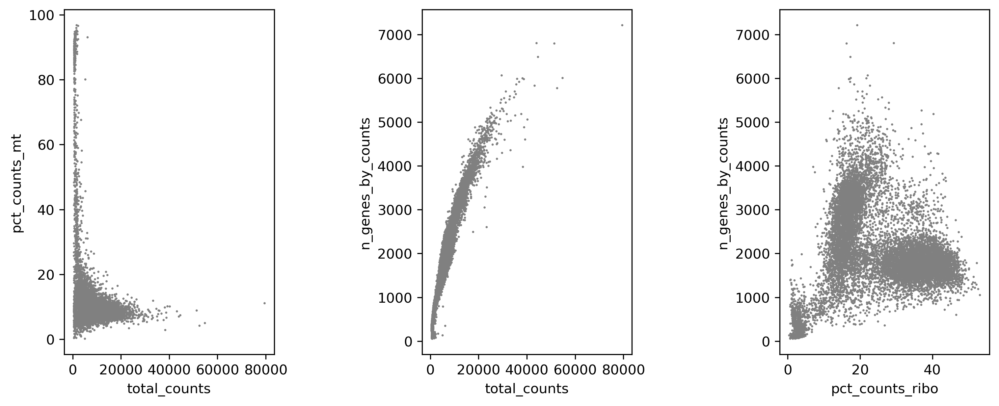

In [39]:
adClean = ad10f.copy()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10,4), gridspec_kw={'wspace':0.25}, constrained_layout=True)
ax1_dict = sc.pl.scatter(adClean, x='total_counts', y='pct_counts_mt', ax=ax1, show=False)
ax2_dict = sc.pl.scatter(adClean, x='total_counts', y='n_genes_by_counts',ax=ax2, show=False)
ax3_dict = sc.pl.scatter(adClean, x='pct_counts_ribo', y='n_genes_by_counts',ax=ax3, show=False)
plt.show()

Now, do the filtering. 

First, keep cells with fewer than 20% mitochondrially encoded gene total UMIs

In [40]:
adClean = adClean[adClean.obs['pct_counts_mt']<20,:].copy()
adClean.n_obs

11047

- Second, filter based on total number of genes detected (at least 500).
- Third, filter based on total number of counts (fewer than than 30,000)
- Fourth, keep genes that are detected in at least 10 cells.

In [43]:
adClean.var_names_make_unique()
sc.pp.filter_cells(adClean, min_genes=500)
print(adClean.n_obs)

sc.pp.filter_cells(adClean, max_counts=30000)
print(adClean.n_obs)

sc.pp.filter_genes(adClean, min_cells=10)
print(adClean.shape)

10924
10891
(10891, 17422)


### Normalization
Simple library size scaling, then log transform. There are many other ways to correct for cell-to-cell technical variation, for example different cell lysis efficiencies, but this method is good enough for this data set and our goals.

In [44]:
adNorm = adClean.copy()
sc.pp.normalize_total(adNorm , target_sum=1e4)
sc.pp.log1p(adNorm)
adNorm.layers['lognorm'] = adNorm.X.copy()

### Highly variable genes (HVG)
It is common practice to limit some parts of analysis to those variables/genes that exhibit some degree of variation in their values across the data. We call these <i>highly variable genes</i>, or HVG for short. To find these, calculate some gene statistics, which when combined with thresholds below, determine which genes are considered HVG. 
The relevant metrics are:

1. <i>mean expression</i>
2. <i>dispersion</i>, which is the variance / mean.

Variance is defined as the expected squared deviation of gene expression.
The normalized dispersion is calculated by scaling based on a bin of mean expression.

In [45]:
n_hvg = 2000
sc.pp.highly_variable_genes(adNorm, n_top_genes=n_hvg, flavor='cell_ranger')
# sc.pp.highly_variable_genes(adNorm , min_mean=0.0125, max_mean=6, min_disp=0.25)
adNorm.var

,gene_ids,feature_types,genome,mt,ribo,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells,highly_variable,means,dispersions,dispersions_norm
AL627309.1,ENSG00000238009,Gene Expression,GRCh38,False,False,60,0.005183,99.490186,61.0,60,False,0.004502,0.917161,-0.060098
AL669831.5,ENSG00000237491,Gene Expression,GRCh38,False,False,679,0.062367,94.230606,734.0,665,False,0.048407,0.856350,-0.258551
FAM87B,ENSG00000177757,Gene Expression,GRCh38,False,False,13,0.001190,99.889540,14.0,13,False,0.000770,0.719899,-1.331091
LINC00115,ENSG00000225880,Gene Expression,GRCh38,False,False,350,0.031269,97.026085,368.0,337,False,0.024243,0.848471,-0.828740
FAM41C,ENSG00000230368,Gene Expression,GRCh38,False,False,313,0.027190,97.340471,320.0,308,False,0.022719,0.883760,-0.320399
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC011043.1,ENSG00000276256,Gene Expression,GRCh38,False,False,77,0.006882,99.345739,81.0,74,False,0.005875,0.988261,0.642865
AL592183.1,ENSG00000273748,Gene Expression,GRCh38,False,False,32,0.002719,99.728099,32.0,30,False,0.002267,0.978485,0.592432
AC007325.4,ENSG00000278817,Gene Expression,GRCh38,False,False,239,0.020902,97.969241,246.0,233,False,0.015576,0.787513,-1.681796
AL354822.1,ENSG00000278384,Gene Expression,GRCh38,False,False,319,0.028210,97.289489,332.0,303,False,0.023072,0.906420,0.006022


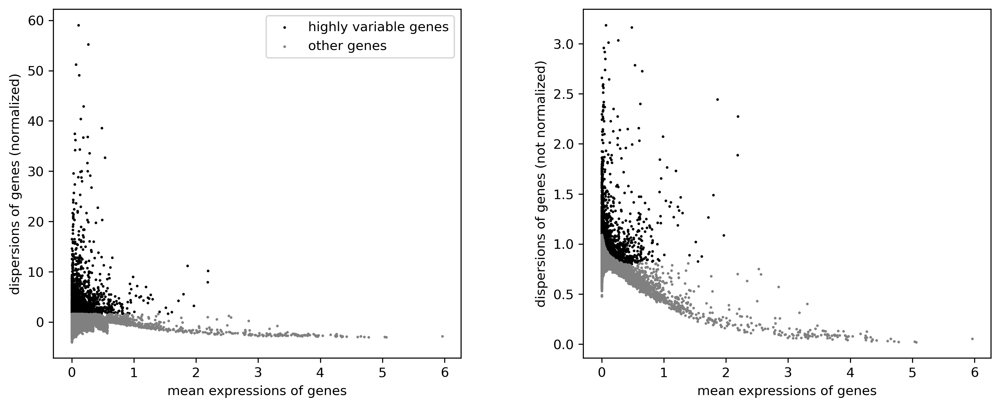

In [46]:
sc.pl.highly_variable_genes(adNorm)

### Dimensionality reduction with Principal components analysis (PCA)

Why performan dimentaionality reduction?

1. Genes are expressed in coordinated fashion, meaning that many have correlated expression patterns and so PCA reduces the computational complexity of downstream analysis
2.  scRNA-seq data is noisy on a per gene basis.

PCA allows us to reduce a high dimensional data set into a lower dimension in which much of the total variation is maintained. To understand PCA, you need to know linear algebra. In essence, it identifies sets of linear combinations of genes in such a way that a PC is uncorrelated with other PCs and that explains most variation in the data. The function call `sc.tl.pca` does the following:

1. computes the covariance matrix (correlation between each pair of genes)
2. finds eigenvectors (directions of axes that maximize that variance), orthogonal to each other

Later, we select a threshold (n_pcs) as the number of PCs that contribute most to the total variation on our data. We use these _n_pcs_ PCs to compute cell-to-cell distances for embedding (2D visualization via UMAP) and for clustering of cells. 

In [47]:
adNorm

AnnData object with n_obs × n_vars = 10891 × 17422
    obs: 'sample_name', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'
    layers: 'counts', 'lognorm'

In [48]:
sc.tl.pca(adNorm , mask_var='highly_variable')
adNorm

AnnData object with n_obs × n_vars = 10891 × 17422
    obs: 'sample_name', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'lognorm'

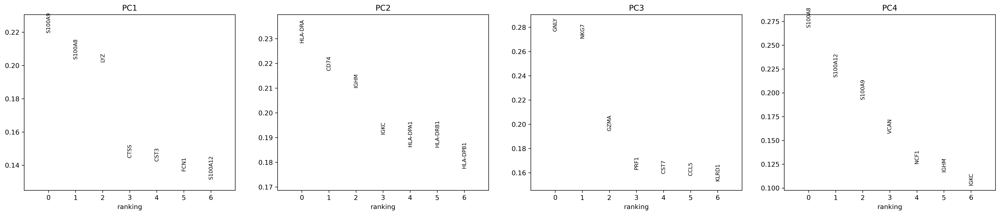

In [49]:
sc.pl.pca_loadings(adNorm, components = [1,2,3,4], n_points=6, include_lowest=False)

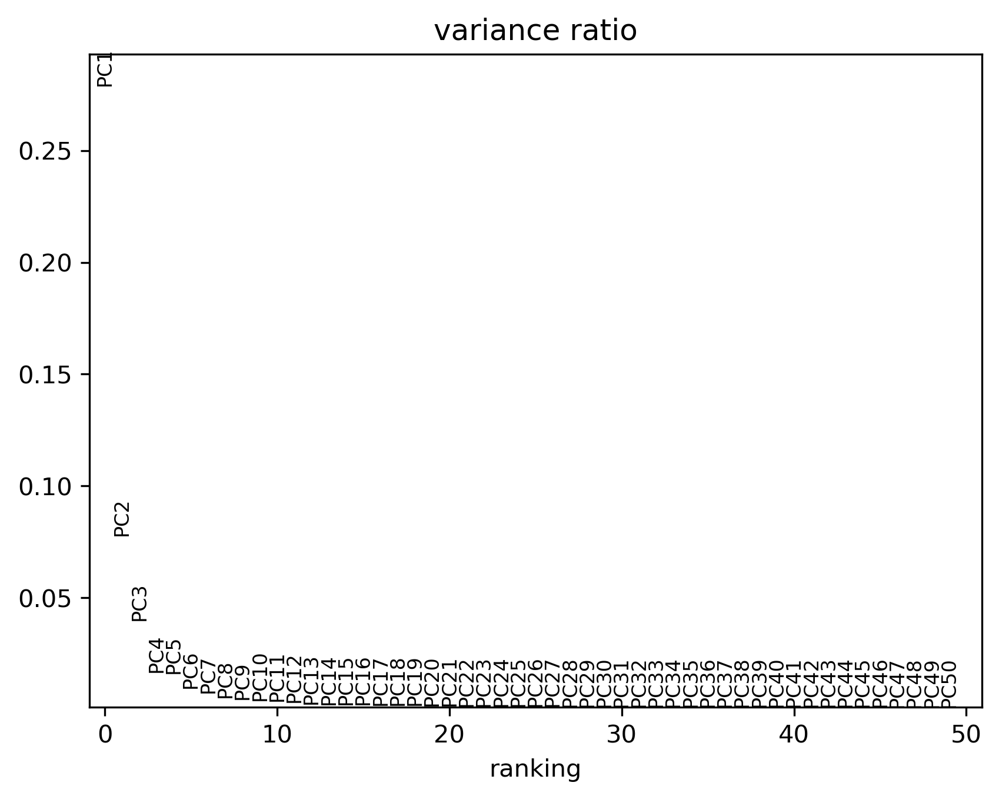

In [50]:
sc.pl.pca_variance_ratio(adNorm, 50)

### Marker genes
Here PBMC cell types and some genes that have been used to identify them:<br>
**Monocytes**: CD14, CD68, LYZ<br>
**Dendritic**: CLEC4C, FLT3<br>
**NK cells**: GNLY, NCAM1<br>
**B cells**: CD19, CD79A, CD79B<br>
**T cells**: CD3D, CD3E, TRAC, TRBC<br>


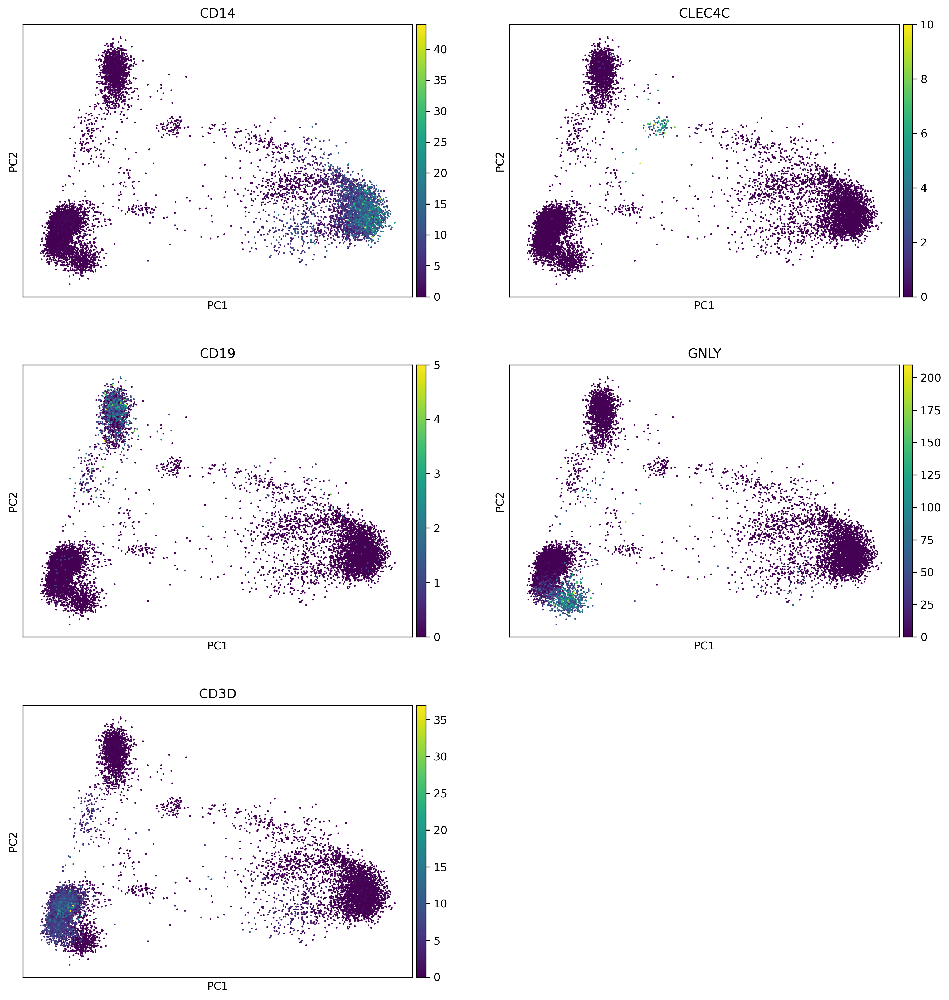

In [51]:
markerGenes = ['CD14','CLEC4C', 'CD19',  'GNLY', 'CD3D']
sc.pl.pca(adNorm , color=markerGenes, ncols=2, layer='counts')

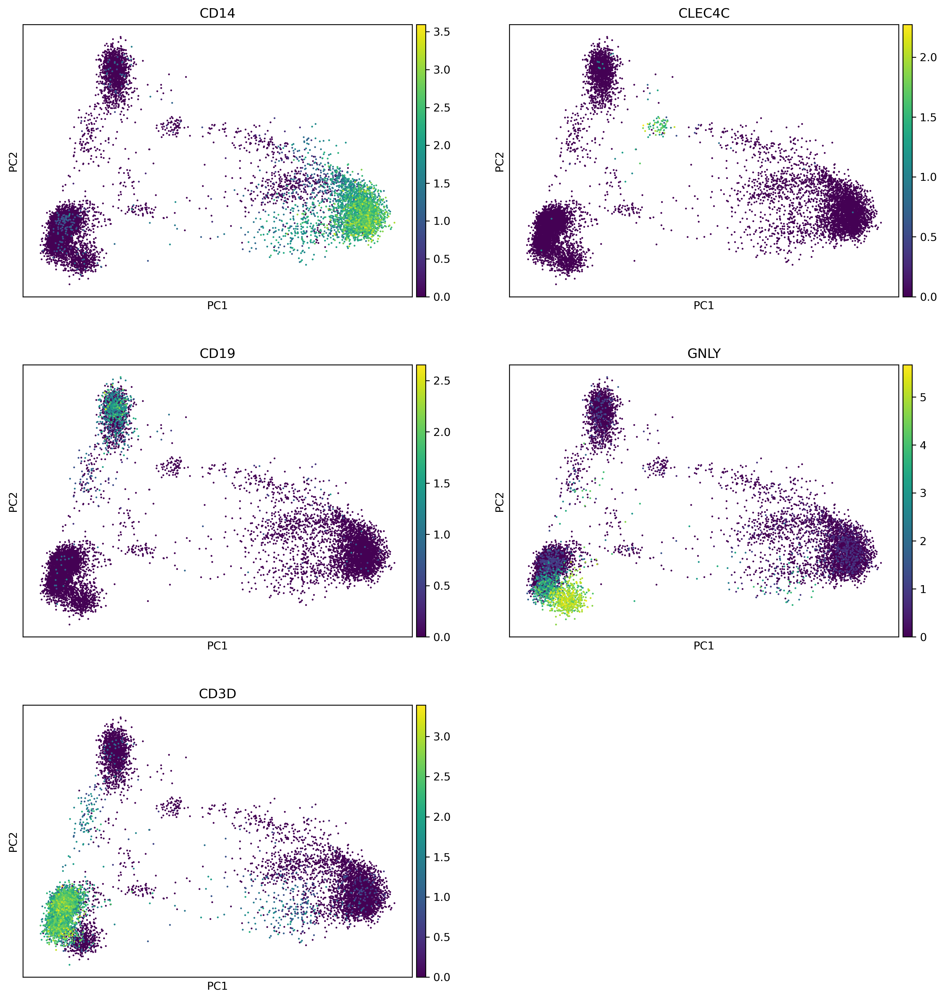

In [52]:
sc.pl.pca(adNorm , color=markerGenes, ncols=2)

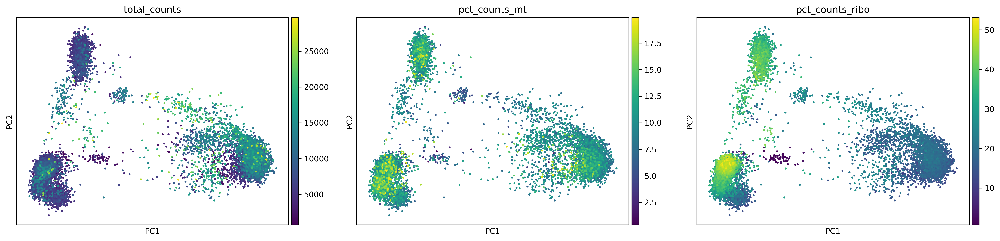

In [53]:
sc.pl.pca(adNorm, color=['total_counts', 'pct_counts_mt', 'pct_counts_ribo'], s=25,ncols=3)

#### kNN cell-cell distances
The k-nearest neighbor graph generates an adjacency matrix by finding, for each cell, the k cells that are closest to it. This helps to reduce noise in computing cell-cell distances or similarities and is important for embedding the cells in a 2D space, and for community detection algorithms. Two arguments are n_neighbors, or _k_, and the number of PCs to use when computing cell-cell distances. 

In [54]:
n_neighbors = 20
n_pcs = 10
sc.pp.neighbors(adNorm, n_neighbors=n_neighbors, n_pcs=n_pcs)
adNorm

AnnData object with n_obs × n_vars = 10891 × 17422
    obs: 'sample_name', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg', 'pca', 'neighbors'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'lognorm'
    obsp: 'distances', 'connectivities'

### Visualization of cell-cell similarities 

#### UMAP embedding
This an elaboration on the t-SNE embedding approach. Both of these methods try to project cells into a reduced (typically 2) dimensional coordinate system while maintaining both the global and local structure of the high dimensional space of the data (i.e. cells that are distant from each other high dimensions should still be distant in the reduced embedding; same is true for cells that are near each other). The distances come from the kNN graph.

In [55]:
sc.tl.umap(adNorm)

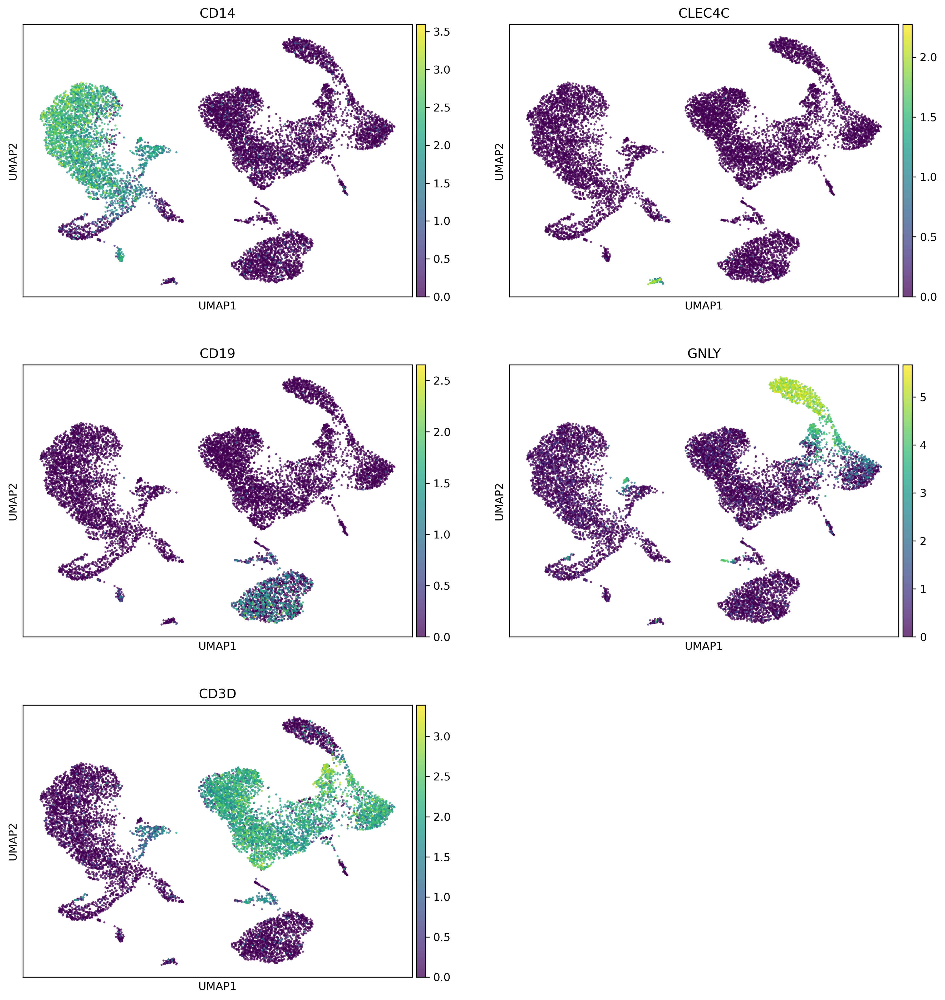

In [56]:
sc.pl.umap(adNorm, color=markerGenes, alpha=.75, s=15, ncols=2)

There are lots of ways to customize our plots. See the Scanpy [visualization documentation](https://scanpy.readthedocs.io/en/stable/tutorials/plotting/advanced.html) for details. Here, lets change the colors and remove the boxes and axes labels.

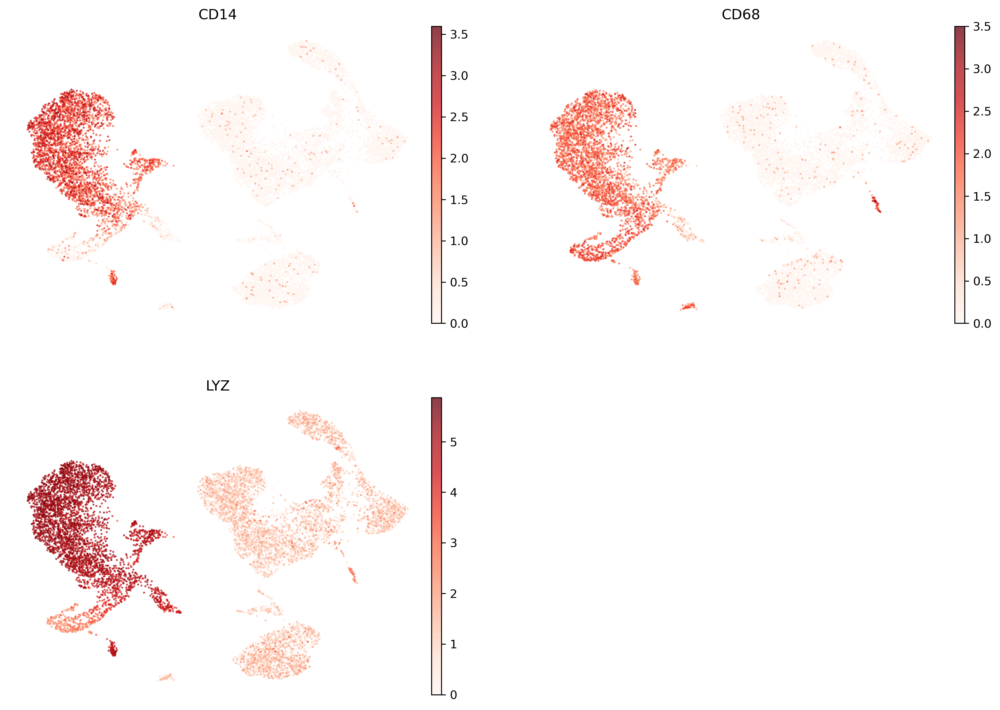

In [57]:
sc.pl.umap(adNorm, color= genes_monocyte, alpha=.75, s=12, frameon=False, ncols=2, legend_fontoutline=2,legend_fontsize=14, cmap="Reds")

### Unsupervised clustering

Let's try to assign cells to distinct groups or clusters based on the cell-to-cell distances. Leiden and Louvain are examples of community detection methods that perform this task by searching for the group assignment that maximize within group similarity (which is equivalent to within group edges of a knn graph) and to minimize between group similarity. 


In [66]:
clustering_name = "leiden_cluster"
sc.tl.leiden(adNorm, 0.1, flavor="igraph", n_iterations=2,key_added=clustering_name)

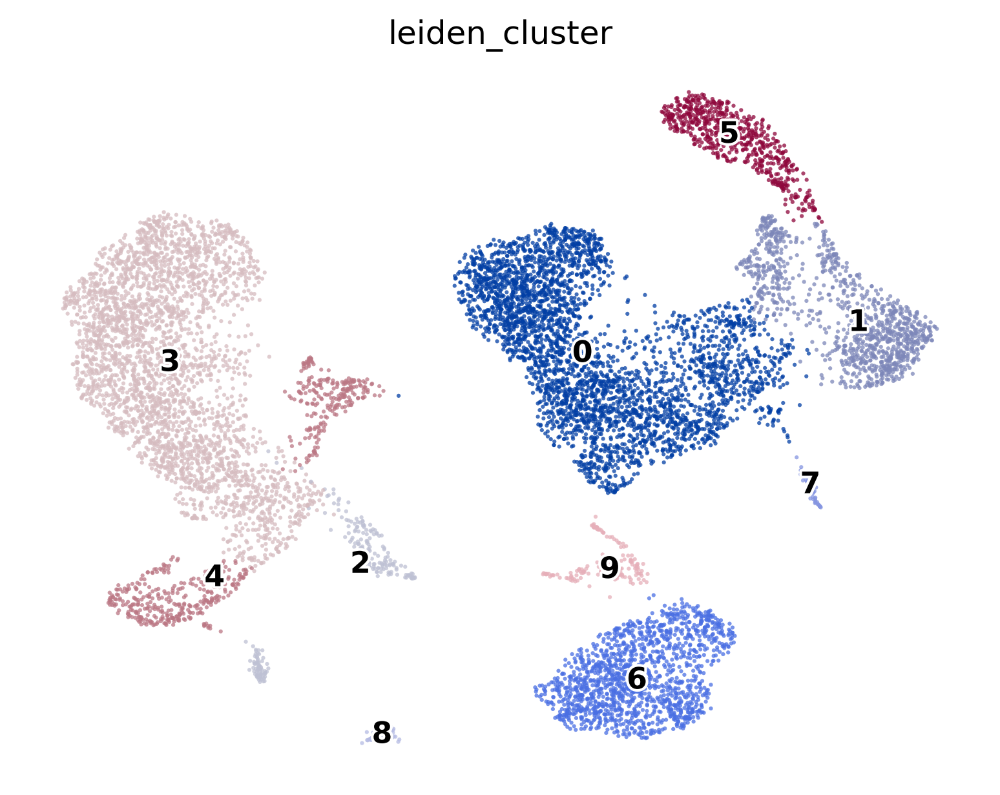

In [67]:
sc.pl.umap(adNorm, color=[clustering_name], alpha=.75, s=9, legend_loc='on data', frameon=False, ncols=1, legend_fontoutline=2,legend_fontsize=11, cmap="Reds", use_raw=False)

Make a figure that shows the embedding and expression of marker genes side-by-side. Note that I am adding markers for T cell, B cell, and Monocyte sub-types

categories: 0, 1, 2, etc.
var_group_labels: B cell, Dendritic, Monocyte, etc.


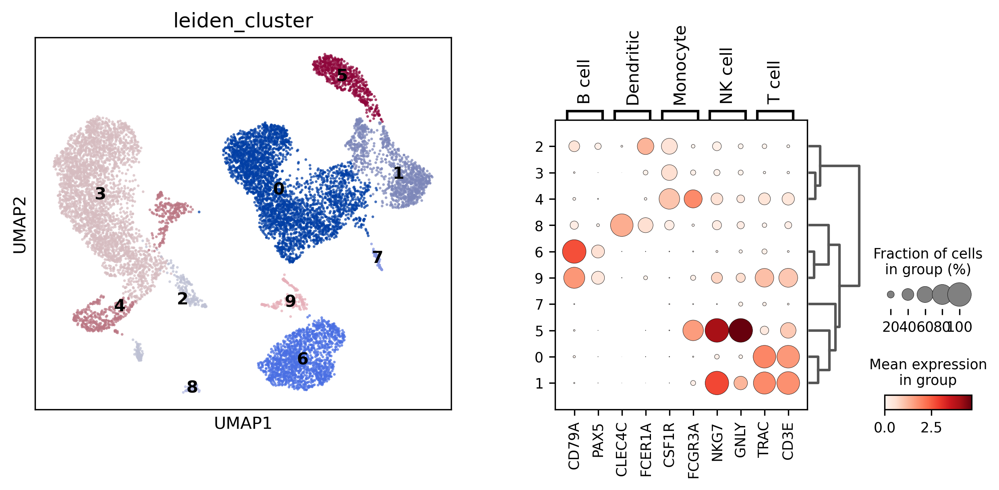

In [71]:
marker_genes_broad_dict = {
    'B cell': ['CD79A', 'PAX5'],
    'Dendritic': ['CLEC4C', 'FCER1A'],
    'Monocyte': ['CSF1R', 'FCGR3A'],
    'NK cell': ['NKG7', 'GNLY'],
    'T cell': ['TRAC', 'CD3E'],
}
sc.tl.dendrogram(adNorm, groupby=clustering_name)


fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4), gridspec_kw={'wspace':0.25})
ax1_dict = sc.pl.umap(adNorm,color=[clustering_name], alpha=.75, s=10, legend_loc='on data', ax=ax1, show=False)
ax2_dict = sc.pl.dotplot(adNorm, marker_genes_broad_dict, groupby=clustering_name, dendrogram=True,ax=ax2, show=False)
plt.show()

## STOP HERE FOR NOW

### Cluster annotation
We can walk down the rows of the dotplot and guess at the cell types of some of these clusters based on the specificty of marker expression:

| cluster | markers  of          | cell type       |
|---------|----------------------|-----------------|
| 5       | B, Dendritic, Mono   | ???             |
| 1       | Monocyte             | Monocyte        |
| 4       | Monocyte, T          | ???            |
| 3       | B                    | B-cell          |
| 6       | Dendritic (B/Mono?)  | Dendritic cell  |
| 7       | none                 | Mystery cell    | 
| 0  | T cell | T cell |
| 2 |  NK/T | ??? |

Some clusters are ambiguous because they express markers of more than one cell type. This could be due to the cluster containing > 1 cell type, or because the cell barcodes are doublets. If the former, then we should be able to sub cluster them. Let's try this.

Clusters to refine are 5, 4, and 2.

categories: 0, 1, 2, etc.
var_group_labels: B cell, Dendritic, Monocyte, etc.


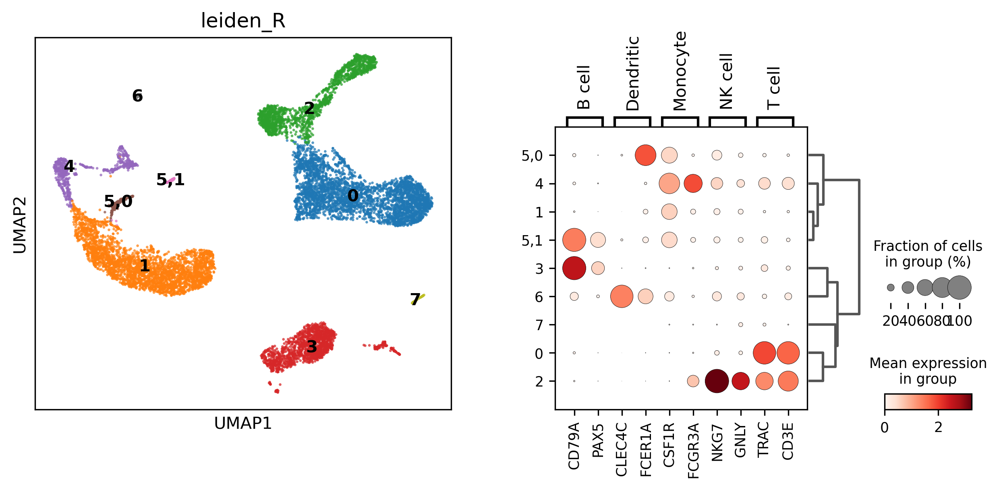

In [48]:
sc.tl.leiden(adNorm,.1, restrict_to=["leiden",["5"]])
sc.tl.dendrogram(adNorm, "leiden_R")
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4), gridspec_kw={'wspace':0.25})
ax1_dict = sc.pl.umap(adNorm,color=['leiden_R'], alpha=.75, s=10, legend_loc='on data', ax=ax1, show=False)
ax2_dict = sc.pl.dotplot(adNorm, marker_genes_broad_dict, 'leiden_R', dendrogram=True,ax=ax2, show=False)
plt.show()

Cluster 5 is split into 2 clusters now. Both of these sub-clusters express the Monocyte marker CD14, but are distinguished by their expression of dendritic marker FCER1A and the B cell genes CD79A and PAX5. Let's look at the QC metrics to see if that can give us additional hints as to whether these are real cells or are doublets.

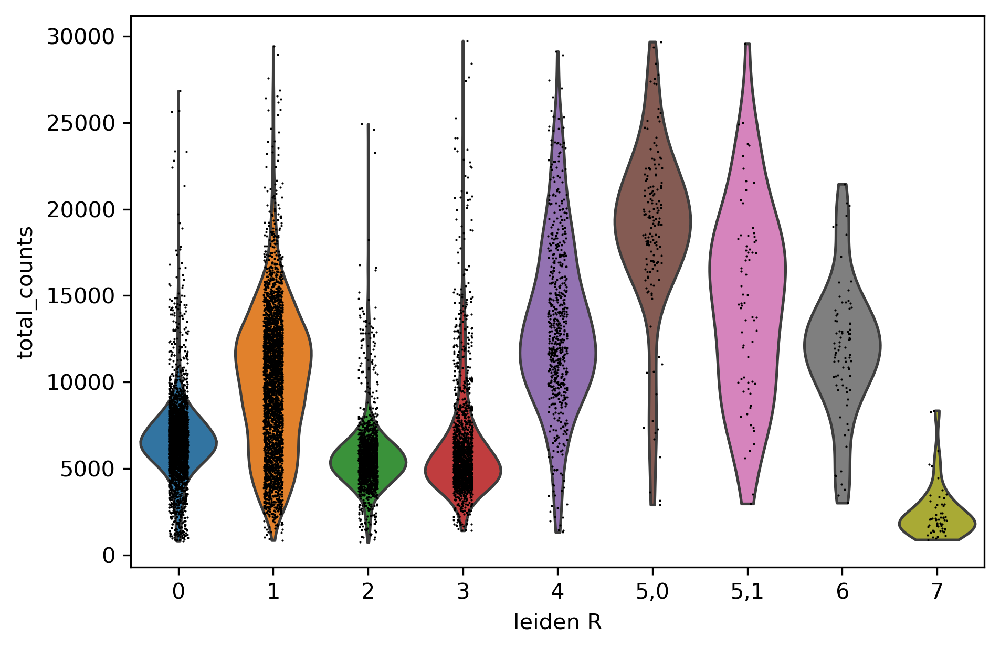

In [49]:
sc.pl.violin(adNorm, ['total_counts'], groupby='leiden_R' )

Cluster 5 (and each sub-cluster) has a high number of Total counts. So let's annotate these as 'doublet'. 

What about the other questionable clusters 4 and 2? Can we refine those?

categories: 0, 1, 2,0, etc.
var_group_labels: B cell, Dendritic, Monocyte, etc.


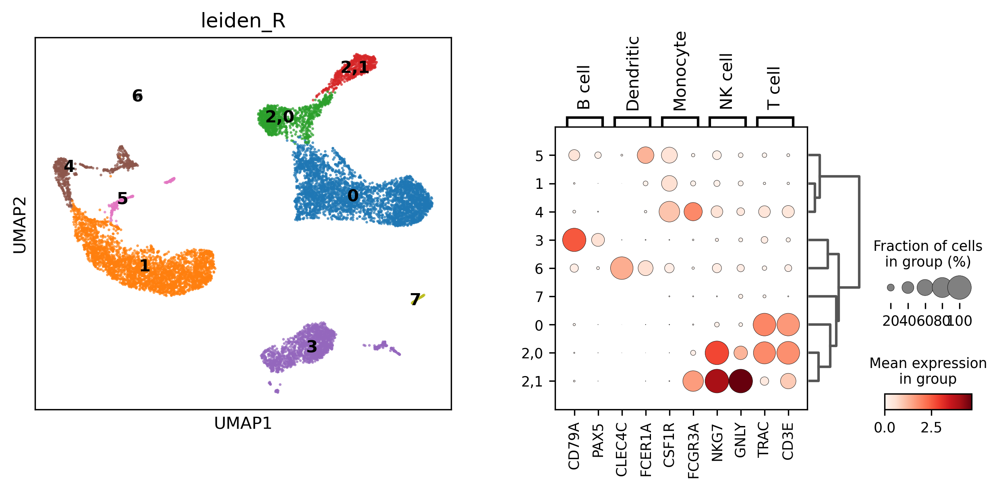

In [50]:
# cluster 2 first
sc.tl.leiden(adNorm,.05, restrict_to=["leiden",["2"]])
sc.tl.dendrogram(adNorm, "leiden_R")
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4), gridspec_kw={'wspace':0.25})
ax1_dict = sc.pl.umap(adNorm,color=['leiden_R'], alpha=.75, s=10, legend_loc='on data', ax=ax1, show=False)
ax2_dict = sc.pl.dotplot(adNorm, marker_genes_broad_dict, 'leiden_R', dendrogram=True,ax=ax2, show=False)
plt.show()

It looks like 2,0 is T cell, and 2,1 is Natural Killer cell.
Note that 2,0 still has a distinct profile as compared to 0. 

What about cluster 4? And this time, when we do the sub-clustering, let's keep the way that we split up cluster 2.

categories: 0, 1, 2,0, etc.
var_group_labels: B cell, Dendritic, Monocyte, etc.


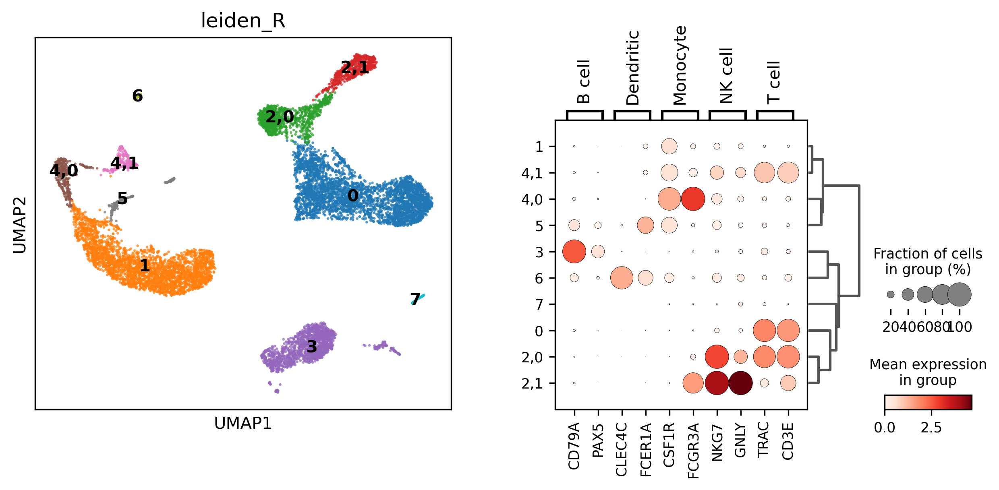

In [51]:
sc.tl.leiden(adNorm,.1, restrict_to=["leiden_R",["4"]])
sc.tl.dendrogram(adNorm, "leiden_R")
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4), gridspec_kw={'wspace':0.25})
ax1_dict = sc.pl.umap(adNorm,color=['leiden_R'], alpha=.75, s=10, legend_loc='on data', ax=ax1, show=False)
ax2_dict = sc.pl.dotplot(adNorm, marker_genes_broad_dict, 'leiden_R', dendrogram=True,ax=ax2, show=False)
plt.show()

Is 4,1 multiplet?

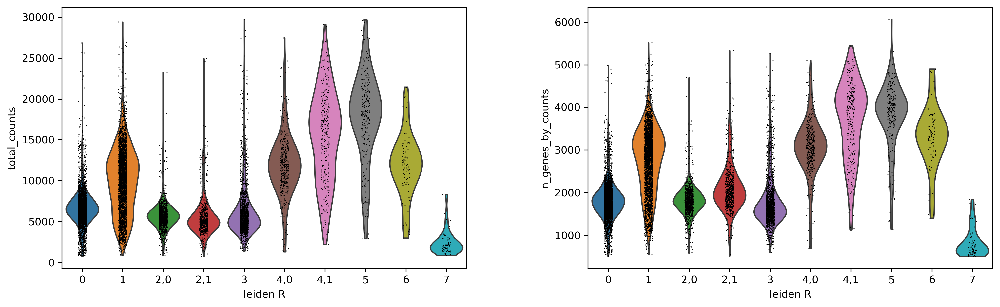

In [52]:
sc.pl.violin(adNorm, ['total_counts', 'n_genes_by_counts'], groupby='leiden_R' )

Yes, it looks like 4,1 is similar in these QC profiles to cluster 5.

So our updated annotation table is now:

| cluster | markers  of          | cell type       |
|---------|----------------------|-----------------|
| 5       | B, Dendritic, Mono   | doublet            |
| 1       | Monocyte             | Monocyte        |
| 4,0     | Monocyte           | Monocyte       |
| 3       | B                    | B-cell          |
| 6       | Dendritic (B/Mono?)  | Dendritic cell  |
| 7       | none                 | Mystery cell    | 
| 0  | T cell | T cell |
| 2,0  | T cell | T cell |
| 2,1 |  NK cell | NK cell |

Why do we have two Monocyte clusters and two T cells clusters?

categories: 0, 1, 2,0, etc.
var_group_labels: B cell, Dendritic, CD14 monocyte, etc.


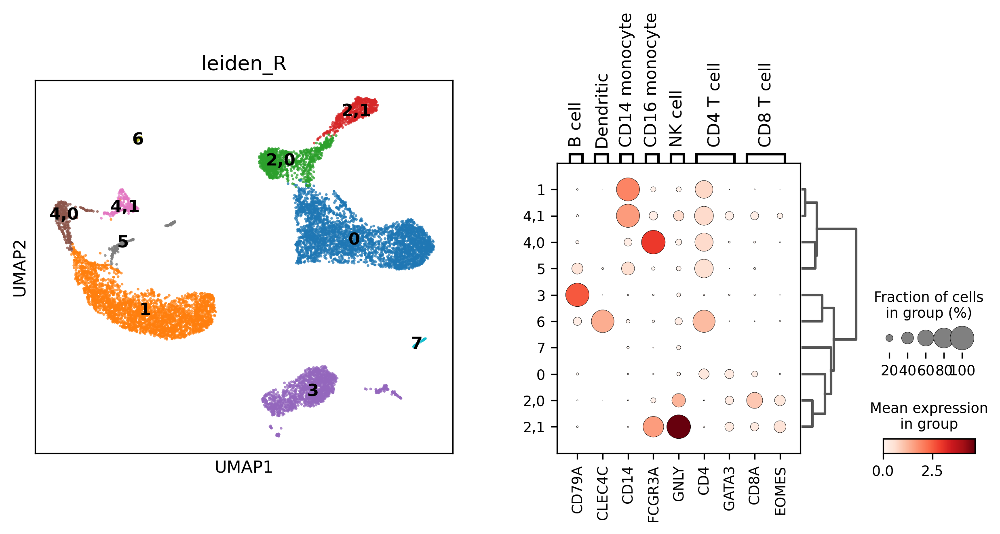

In [53]:
marker_genes_sub_dict = {
    'B cell': ['CD79A'],
    'Dendritic': ['CLEC4C'],
    'CD14 monocyte': ['CD14'],
    'CD16 monocyte': ['FCGR3A'],
    'NK cell': ['GNLY'],
    'CD4 T cell': ['CD4', 'GATA3'],
    'CD8 T cell': ['CD8A', 'EOMES']
}

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,4), gridspec_kw={'wspace':0.25})
ax1_dict = sc.pl.umap(adNorm,color=['leiden_R'], alpha=.75, s=10, legend_loc='on data', ax=ax1, show=False)
ax2_dict = sc.pl.dotplot(adNorm, marker_genes_sub_dict, 'leiden_R', dendrogram=True,ax=ax2, show=False)
plt.show()

We are close to a final annotation now:

| cluster | markers  of          | cell type       |
|---------|----------------------|-----------------|
| 5       | B, Dendritic, Mono   | doublet            |
| 1       | Monocyte             | CD14 Monocyte        |
| 4,0     | Monocyte           | CD16 Monocyte       |
| 3       | B                    | B-cell          |
| 6       | Dendritic (B/Mono?)  | Dendritic cell  |
| 7       | none                 | Mystery cell    | 
| 0  | T cell | CD4 T cell |
| 2,0  | T cell | CD8 T cell |
| 2,1 |  NK cell | NK cell |

But what is cluster 7? It has low counts. If it is just ambient 'soup', then we would not expect it to have high levels of cell type specific genes. Let's do differential gene expression analysis to see what is upregulated in this cluster.

### Differential gene expression

In [54]:
sc.tl.rank_genes_groups(adNorm, use_raw=False, groupby="leiden_R")

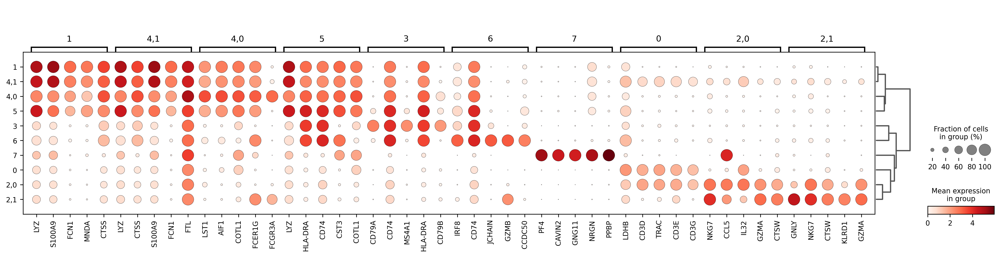

In [55]:
sc.pl.rank_genes_groups_dotplot(adNorm, n_genes=5, groupby="leiden_R", dendrogram=True, key='rank_genes_groups')

categories: 0, 1, 2,0, etc.
var_group_labels: 7


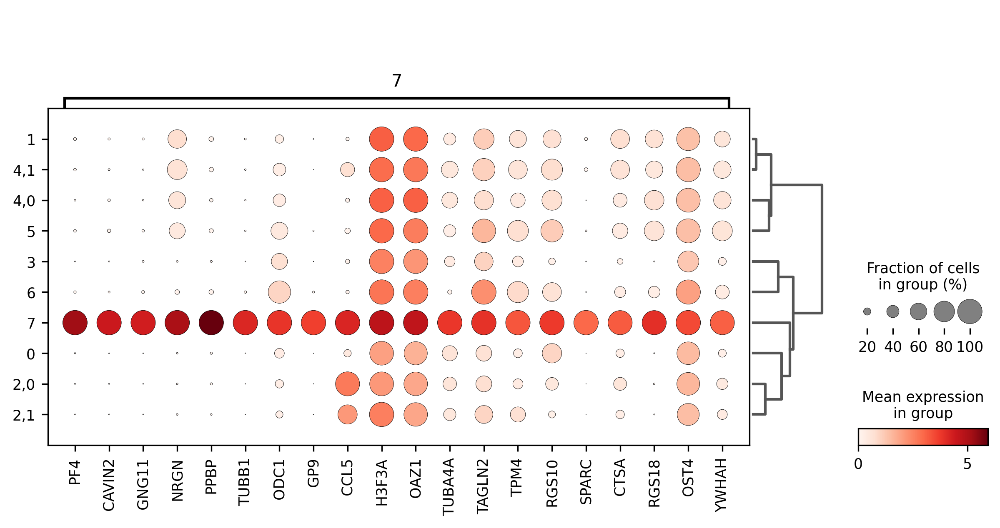

In [56]:
sc.pl.rank_genes_groups_dotplot(adNorm, n_genes=20, groupby="leiden_R", dendrogram=True, key='rank_genes_groups', groups=['7'])

Although this result could be refined and explored a lot, it is sufficient for us to address our question about the identity of cluster 7 as follows:

<figure>
    <img src="./img/ChatGPT_cellguess.png" alt="Help from ChatGPT" width="600">
    <figcaption>Help from ChatGPT to annotate cells</figcaption>
</figure>


Now, let's add the annotation to the anndata.obs and discard the other cells

| cluster | markers  of          | cell type       |
|---------|----------------------|-----------------|
| 1       | Monocyte             | CD14 Monocyte        |
| 4,0     | Monocyte           | CD16 Monocyte       |
| 3       | B                    | B-cell          |
| 6       | Dendritic (B/Mono?)  | Dendritic cell  |
| 7       | none                 | Platelet    | 
| 0  | T cell | CD4 T cell |
| 2,0  | T cell | CD8 T cell |
| 2,1 |  NK cell | NK cell |



In [57]:
tokeep = ["1", "4,0", "3", "6", "7", "0", "2,0", "2,1"]
adNorm2 = adNorm.copy()
adNorm2 = adNorm2[adNorm2.obs['leiden_R'].isin(tokeep)].copy()
adNorm2.shape
adNorm2.obs['leiden_R'].value_counts()

leiden_R
0      3563
1      3115
3      1604
2,0    1031
2,1     611
4,0     368
6        81
7        60
Name: count, dtype: int64

In [58]:
cell_dict = {'Dendritic': ['6'],
             'CD14 Monocyte': ['1'],
             'CD16 Monocyte': ["4,0"],
             'B cell': ['3'],
             'Platelet': ['7'],
             'CD4 T cell': ['0'],
             'CD8 T cell': ["2,0"],
             'NK cell': ["2,1"]
}

marker_genes_dict = {
    'B cell': ['CD79A'],
    'Dendritic': ['CLEC4C'],
    'CD14 monocyte': ['CD14'],
    'CD16 monocyte': ['FCGR3A'],
    'NK cell': ['GNLY'],
    'CD4 T cell': ['CD4', 'GATA3'],
    'CD8 T cell': ['CD8A', 'EOMES'],
    'Platelet': ['PF4', 'CAVIN2']
}


new_obs_name = 'cell_type'
adNorm2.obs[new_obs_name] = np.nan

for i in cell_dict.keys():
    ind = pd.Series(adNorm2.obs.leiden_R).isin(cell_dict[i])
    adNorm2.obs.loc[ind,new_obs_name] = i

adNorm2.obs['cell_type'] = adNorm2.obs['cell_type'].astype("category") 


/var/folders/1_/v5grqr5n7kj42276bb6ryxj00000gn/T/ipykernel_66578/4042500018.py:28: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Dendritic' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  adNorm2.obs.loc[ind,new_obs_name] = i


categories: B cell, CD14 Monocyte, CD16 Monocyte, etc.
var_group_labels: B cell, Dendritic, CD14 monocyte, etc.


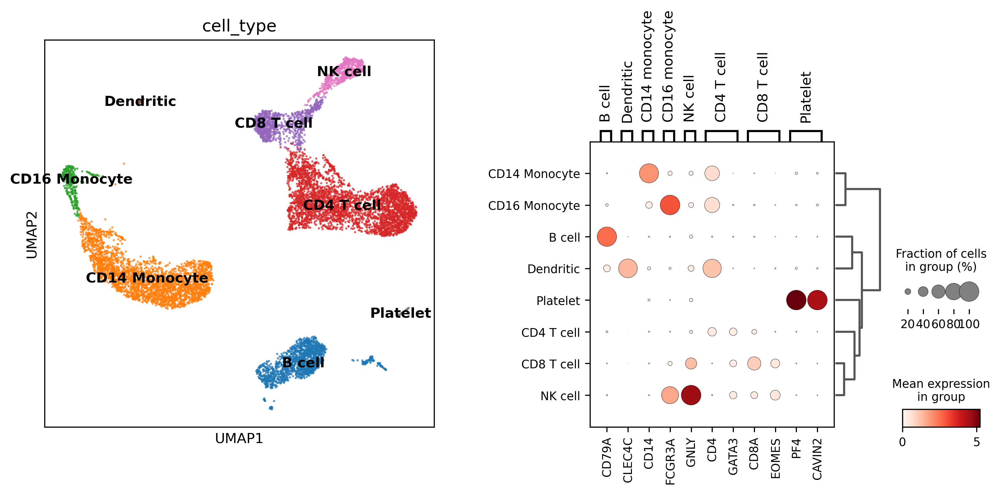

In [59]:
sc.tl.dendrogram(adNorm2, "cell_type")
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,5), gridspec_kw={'wspace':0.4})
ax1_dict = sc.pl.umap(adNorm2,color=['cell_type'], alpha=.75, s=10, legend_loc='on data', ax=ax1, show=False)
ax2_dict = sc.pl.dotplot(adNorm2, marker_genes_dict, 'cell_type', dendrogram=True,ax=ax2, show=False)
plt.show()


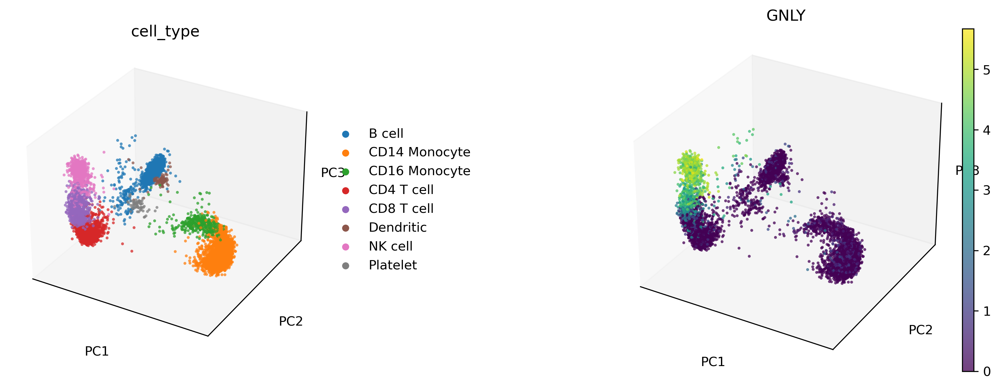

In [60]:
sc.pl.pca(adNorm2, color=['cell_type', 'GNLY'], alpha=.75, s=15, projection='3d')

#### Differential expression analysis
Let's identify genes that are preferenntially expressed in each cluster versus all the others as a final step to annotate these clusters and to remove ones that are likely to be doublets.

In [61]:
sc.tl.rank_genes_groups(adNorm2, use_raw=False, groupby="cell_type")

##### Dot plot of differentially expressed genes
First, we will apply a filter so that we only display genes that meet additional criteria beyond statistical: fold change, % expressed in cluster, % expressed in other cells

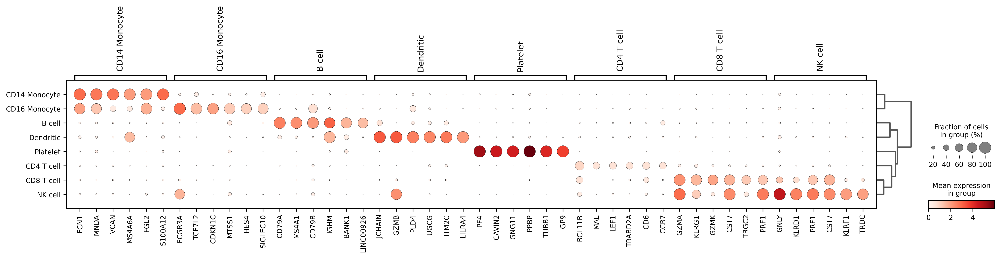

In [62]:
sc.tl.filter_rank_genes_groups(adNorm2, min_fold_change=.7, min_in_group_fraction=.5, max_out_group_fraction=.15)
sc.pl.rank_genes_groups_dotplot(adNorm2, n_genes=6, groupby="cell_type", dendrogram=True, key='rank_genes_groups_filtered')

### Resources

#### Tools
- Colab
	- https://colab.research.google.com/
- Jupyter
	- https://jupyter.org/
- CellRanger
	- https://www.10xgenomics.com/support/software/cell-ranger/latest/advanced/cr-barcode-rank-plot
	- https://www.10xgenomics.com/support/software/cell-ranger/latest/algorithms-overview/cr-gex-algorithm

#### Literature
- Best practices
    - [best practices in sc analysis online book](https://www.sc-best-practices.org/preamble.html)
	- [paper associated with the above online book](https://www.embopress.org/doi/full/10.15252/msb.20188746)
- Scanpy
	- https://scanpy.readthedocs.io/en/stable/
	- https://scanpy.readthedocs.io/en/stable/tutorials.html
    - https://scanpy-tutorials.readthedocs.io/en/latest/pbmc3k.html
    - https://scanpy-tutorials.readthedocs.io/en/latest/plotting/advanced.html
    - https://scanpy-tutorials.readthedocs.io/en/latest/plotting/core.html
- AnnData
	- https://anndata.readthedocs.io/en/latest/tutorials/notebooks/getting-started.html
	- https://anndata.readthedocs.io/en/latest/index.html
- QC
	- https://genomebiology.biomedcentral.com/articles/10.1186/s13059-020-02136-7